# CycleGAN Model 2: Curated Ghibli Anime Images and Real-Life US Attraction

Since the Real-Life US Attraction images were mostly images of landscapes and architecture, from the same Ghibli Anime Image dataset, 743 images were selected which has a landscape theme. Model 1 was rerun using this curated dataset.

**Note**: This notebook was originally run on Google Colab and was reading files from Google Drive, but has been amended to reconcile with the local drive data structure required for github upload. Run cells has been copied from Google Colab such as training cell and pasted into this notebook as proof that the model was trained and showing all the expected output and generated images. This notebook may show Notebook Validation Error when opened locally.

In [2]:
#import the libraries
import tensorflow as tf
from keras.initializers import RandomNormal
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense 
from tensorflow.keras.layers import Flatten, BatchNormalization
from tensorflow.keras.layers import Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU, ReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D, Conv2DTranspose
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Concatenate, Rescaling
from tensorflow.keras.optimizers import Adam
import numpy as np
import os 
import time
import matplotlib.pyplot as plt
import pathlib
!pip install visualkeras
import visualkeras
!pip3 install tensorflow-addons
from tensorflow_addons.layers import InstanceNormalization
AUTOTUNE = tf.data.AUTOTUNE

     |████████████████████████████████| 795 kB 5.3 MB/s 
     |████████████████████████████████| 1.1 MB 5.2 MB/s 


Define the size of images, the batch size and hyperparameters

In [10]:
# size of input image
input_img_size = (256, 256, 3)
img_rows, img_cols, channels = 256, 256, 3

# weights initializer for the layers.
weight_initializer = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

# define configuration
buffer_size = 256
batch_size = 1
data_path = '../model_and_gen_img/CycleGAN_2/'
epochs = 200

# hyperparameters
LAMBDA = 10
LAMBDA_IDENT = 0.5

# set Adam optimizer 
gen_g_optimizer = gen_f_optimizer = Adam(lr=0.0002, beta_1=0.5)
dis_x_optimizer = dis_y_optimizer = Adam(lr=0.0002, beta_1=0.5)

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


We will now pre-process the image data

In [11]:
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1] for 'tanh' activation
    return (img / 127.5) - 1.0

In [12]:
def decode_img(img):
  # Convert the compressed string to a 3D uint8 tensor
  img = tf.io.decode_jpeg(img, channels=3)
  # Resize the image to the desired size
  return tf.image.resize(img, [img_rows, img_cols])

In [13]:
def process_path(file_path):
  # Load the raw data from the file as a string
  img = tf.io.read_file(file_path)
  img = decode_img(img)
  return img

In [14]:
def preprocess_train_image(img):
    # Random flip
    img = tf.image.random_flip_left_right(img)
    # Resize to the 256 x 256 first
    img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img

In [20]:
# Load the curated Anime landscape images
data_dir_anime_train = '../data/anime_ghibli_landscape_743/*'
anime_dir_train = pathlib.Path(data_dir_anime_train)
anime_ds_train = tf.data.Dataset.list_files(str(anime_dir_train), shuffle=True)
anime_ds_train = anime_ds_train.map(process_path, num_parallel_calls=AUTOTUNE)
anime_ds_train = anime_ds_train.prefetch(buffer_size=AUTOTUNE)
anime_ds_train = anime_ds_train.take(1216)

In [21]:
#Load the Real Life train images
data_dir_real_train = '../data/real_us_attractions_1976/*'
real_dir_train = pathlib.Path(data_dir_real_train)
real_ds_train = tf.data.Dataset.list_files(str(real_dir_train), shuffle=False)
real_ds_train = real_ds_train.map(process_path, num_parallel_calls=AUTOTUNE)
real_ds_train = real_ds_train.prefetch(buffer_size=AUTOTUNE)
real_ds_train = real_ds_train.take(1216)

We will now create the dataset object

In [22]:
anime_ds_train = anime_ds_train.cache().map(
    preprocess_train_image, num_parallel_calls=AUTOTUNE).shuffle(
    buffer_size).batch(batch_size)

real_ds_train = real_ds_train.cache().map(
    preprocess_train_image, num_parallel_calls=AUTOTUNE).shuffle(
    buffer_size).batch(batch_size)

## Sample Images

Visualize some samples:

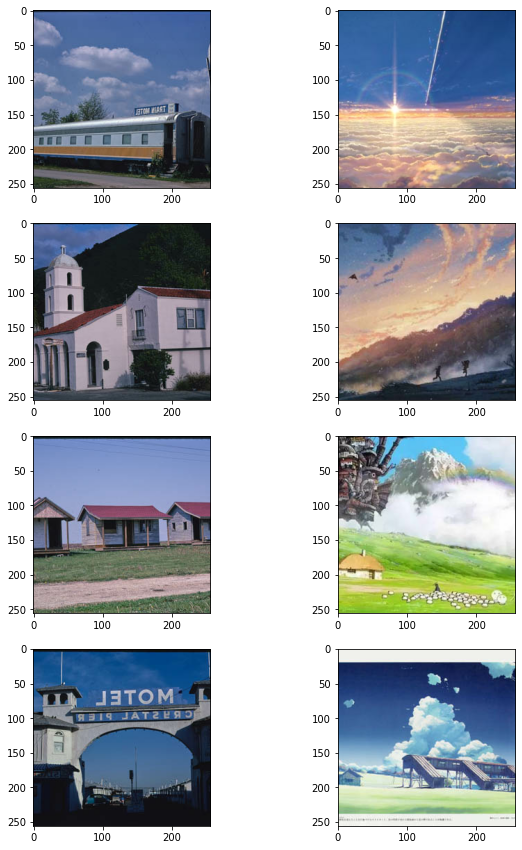

In [23]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, samples in enumerate(zip(real_ds_train.take(4), anime_ds_train.take(4))):
    real = (((samples[0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    anime = (((samples[1][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    ax[i, 0].imshow(real)
    ax[i, 1].imshow(anime)
plt.show();

## Discriminator

Define the Discriminator

In [24]:
# "Ck" denotes a 4 × 4 Convolution-InstanceNorm-LeakyReLU layer with k filters and stride 2
def Ck(input, k, use_instancenorm=True):
    block = Conv2D(k, (4, 4), strides=2, padding='same', kernel_initializer=weight_initializer)(input)
    if use_instancenorm:
        block = InstanceNormalization(axis=-1)(block)
    block = LeakyReLU(0.2)(block)

    return block

# C64, C128, C256, C512
def discriminator():
    dis_input = Input(shape=(img_rows, img_cols, channels))

    d = Ck(dis_input, 64, False)
    d = Ck(d, 128)
    d = Ck(d, 256)
    d = Ck(d, 512)

    d = Conv2D(1, (4, 4), padding='same', kernel_initializer=weight_initializer)(d)

    return Model(dis_input, d)

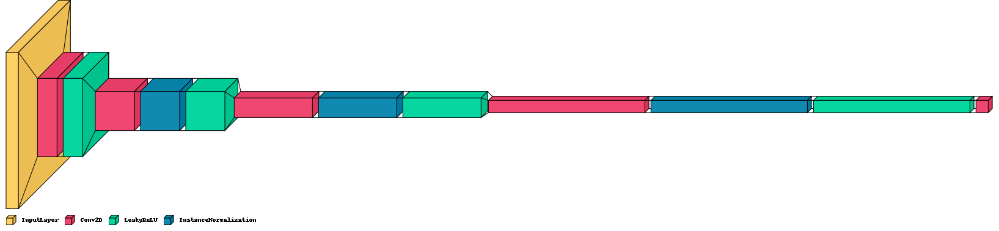

In [25]:
discriminator_cg = discriminator()
visualkeras.layered_view(discriminator_cg, scale_xy = 1, scale_z=0.5, legend=True)

## Generator

Define the Generator

In [26]:
# "dk denotes a 3×3 Convolution-InstanceNorm-ReLU with k filters and stride 2"
def dk(k, use_instancenorm=True):
    block = Sequential()
    block.add(Conv2D(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    if use_instancenorm:
        block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block

# "uk denotes a 3×3 fractional-strided-ConvolutionInstanceNorm-ReLU layer with k filters and stride ½"
def uk(k):
    block = Sequential()
    block.add(Conv2DTranspose(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block

def generator():
    gen_input = Input(shape=(img_rows, img_cols, channels))
    
    # Layers for the encoder part of the model
    encoder_layers = [
        dk(64, False),
        dk(128),
        dk(256),
        dk(512),
        dk(512),
        dk(512),
        dk(512),
        dk(512)
    ]

    # Layers for the decoder part of the model
    decoder_layers = [
        uk(512),
        uk(512),
        uk(512),
        uk(512),
        uk(256),
        uk(128),
        uk(64)
    ]

    gen = gen_input

    # Add all the encoder layers, and keep track of them for skip connections
    skips = []
    for layer in encoder_layers:
        gen = layer(gen)
        skips.append(gen)
    
    skips = skips[::-1][1:] # Reverse for looping and get rid of the layer that directly connects to decoder

    # Add all the decoder layers and skip connections
    for skip_layer, layer in zip(skips, decoder_layers):
        gen = layer(gen)
        gen = Concatenate()([gen, skip_layer])

    
    # Final layer
    gen = Conv2DTranspose(channels, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer, activation='tanh')(gen)
    
    # Compose model
    return Model(gen_input, gen)

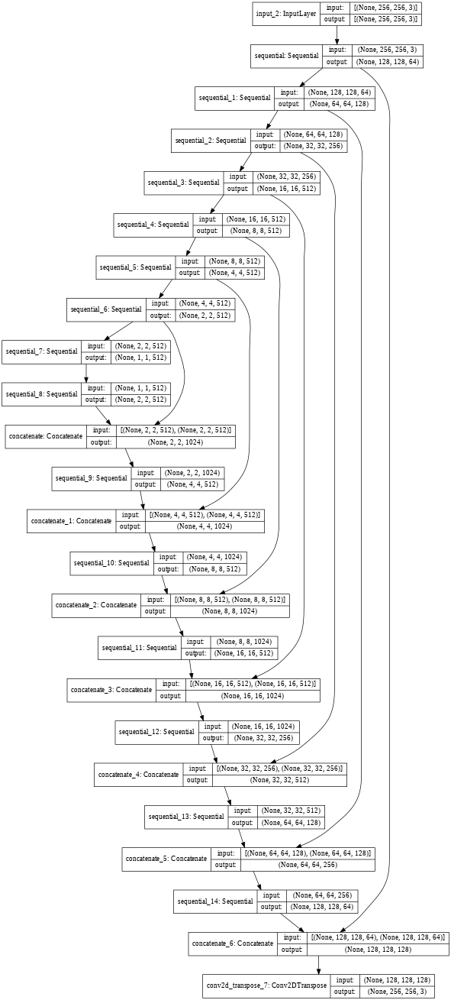

In [27]:
generator_cg = generator()
tf.keras.utils.plot_model(generator_cg, show_shapes=True, dpi=48)

Instantiate the generators and discriminators of the CycleGAN

In [28]:
generator_g = generator() # generates anime images from real-life input images
generator_f = generator() # generates real-life images from anime input images


discriminator_x = discriminator() # takes in real-life and generated real-life images and 
                                  # output probability it is real-life
discriminator_y = discriminator() # takes in anime and generated anime images and 
                                  # output probability it is anime

## Loss Function

Define the loss functions

In [29]:
loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Measures how close to one real images are rated, and how close to zero fake images are rated
def discriminator_loss(real, generated):
    # Multiplied by 0.5 so that it will train at half-speed
    return (loss(tf.ones_like(real), real) + loss(tf.zeros_like(generated), generated)) * 0.5

# Measures how real the discriminator believes the fake image is
def gen_loss(validity):
    return loss(tf.ones_like(validity), validity)

# Measures similarity of two images.  Used for cycle and identity loss
def image_similarity(image1, image2):
    return tf.reduce_mean(tf.abs(image1 - image2))

Define the train step function to update the weights of the generators and discriminators

In [30]:
@tf.function
def step(real_x, real_y):  #real_x : anime, real_y : real-life 
    with tf.GradientTape(persistent=True) as tape:
        # setup Dy loss - how well Discriminator y classify true and generated anime images
        fake_y = generator_g(real_x, training=True) # fake_y : fake anime
        gen_g_validity = discriminator_y(fake_y, training=True)
        dis_y_loss = discriminator_loss(discriminator_y(real_y, training=True), gen_g_validity)

        with tape.stop_recording():
            discriminator_y_gradients = tape.gradient(dis_y_loss, discriminator_y.trainable_variables)
            dis_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

        # setup Dx loss - how well Discriminator x classify true and generated real-life images
        fake_x = generator_f(real_y, training=True) # fake_x : fake real-life
        gen_f_validity = discriminator_x(fake_x, training=True)
        dis_x_loss = discriminator_loss(discriminator_x(real_x, training=True), gen_f_validity)

       # calculate gradient and update weights of discriminators
        with tape.stop_recording():
            discriminator_x_gradients = tape.gradient(dis_x_loss, discriminator_x.trainable_variables)
            dis_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))

        # setup adversarial losses
        gen_g_adv_loss = gen_loss(gen_g_validity) # how well generator_g outputs anime which discriminator_y 
                                                  # thinks is real anime
        gen_f_adv_loss = gen_loss(gen_f_validity) # how well generator_f outputs real-life images which
                                                  # discriminator_y thinks is real-life

        # setup cycle losses
        cyc_x = generator_f(fake_y, training=True) 
        cyc_x_loss = image_similarity(real_x, cyc_x) # similarity between real-life image and generated real-life
                                                     # image from one cycle through generator_g followed by generator_f

        cyc_y = generator_g(fake_x, training=True)
        cyc_y_loss =  image_similarity(real_y, cyc_y) # similarity between anime image and generated anime image
                                                      # from one cycle through generator_f followed by generator_g
        
        # Setup identity losses
        id_x = generator_f(real_x, training=True)
        id_x_loss = image_similarity(real_x, id_x) # similarity between real-life image and generated real-life image
                                                   # through inputting real-life image into generator_f

        id_y = generator_g(real_y, training=True)
        id_y_loss = image_similarity(real_y, id_y) # similarity between anime image and generated anime image
                                                   # through inputting anime image into generator_g

        # Finalize generator losses and calc gradients
        # LAMBDA scales cyclic losses importance w.r.t. adversarial losses
        # LAMBDA_IDENT scales identity losses importance further w.r.t. adversarial losses
        gen_g_loss = gen_g_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_y_loss * LAMBDA_IDENT*LAMBDA
        gen_f_loss = gen_f_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_x_loss * LAMBDA_IDENT*LAMBDA

        # calculate gradient and update weights of generators
        with tape.stop_recording():
            generator_g_gradients = tape.gradient(gen_g_loss, generator_g.trainable_variables)
            gen_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))

            generator_f_gradients = tape.gradient(gen_f_loss, generator_f.trainable_variables)
            gen_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

Define a function for generating and saving a random anime images at each epoch

In [31]:
def generate_images():
    # Sample images
    real = next(iter(real_ds_train.shuffle(1000))).numpy()
    
    # Get predictions for those images. We are only interested in generated anime images from real-life inputs
    anime_hat = generator_g.predict(real.reshape((1, img_rows, img_cols, channels)))
    
    plt.figure(figsize=(15, 7.5))

    images = [real[0], anime_hat[0]]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow(images[i] * 0.5 + 0.5)
        plt.axis('off')
    # plt.tight_layout()

    output_path = os.path.join(data_path,'generated_images')
    if not os.path.exists(output_path):
      os.makedirs(output_path)

    filename = os.path.join(output_path,f"train-{epoch}.png")
    plt.savefig(filename)
    plt.show()

Construct a Checkpoint object

In [32]:
checkpoint_path = data_path +'training_checkpoints'

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           gen_g_optimizer=gen_g_optimizer,
                           gen_f_optimizer=gen_f_optimizer,
                           dis_x_optimizer=dis_x_optimizer,
                           dis_y_optimizer=dis_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


We will now train the model for 200 epochs

Epoch: 0
0
100
200
300
400
500
600
700


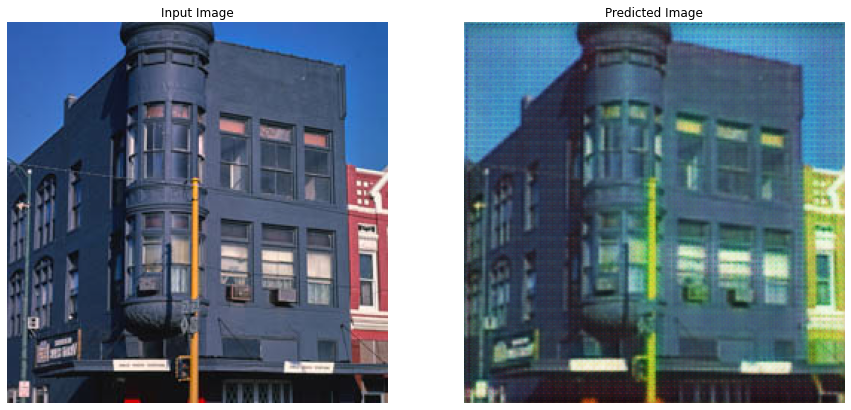

Time taken: 353.7566065788269
Epoch: 1
0
100
200
300
400
500
600
700


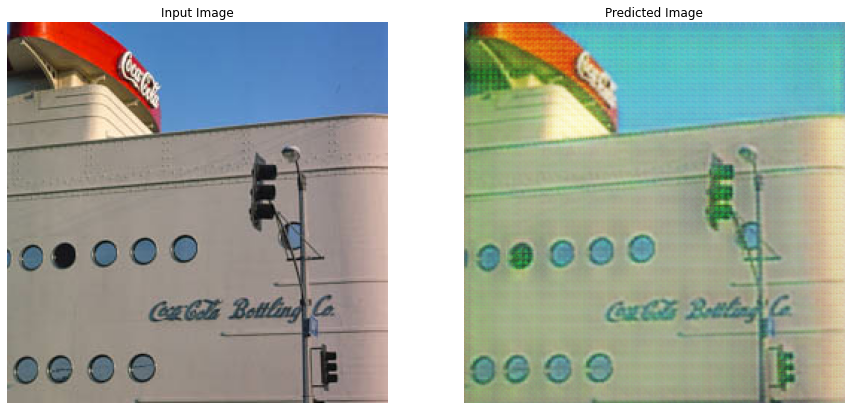

Time taken: 114.76106548309326
Epoch: 2
0
100
200
300
400
500
600
700


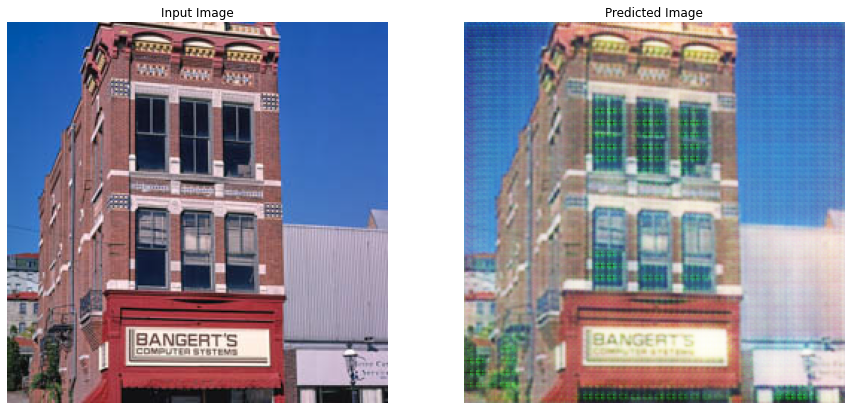

Time taken: 114.72449469566345
Epoch: 3
0
100
200
300
400
500
600
700


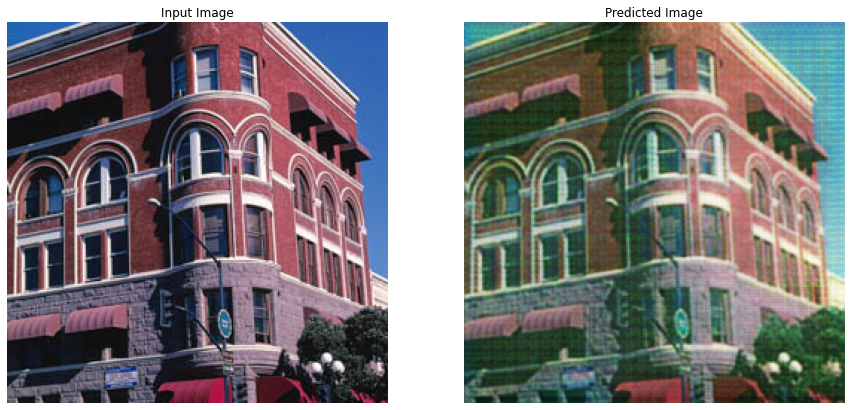

Time taken: 114.83504915237427
Epoch: 4
0
100
200
300
400
500
600
700


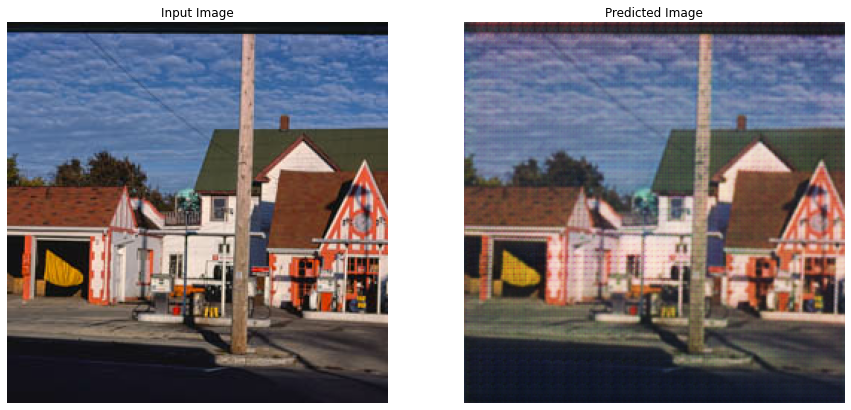

Time taken: 114.82782816886902
Epoch: 5
0
100
200
300
400
500
600
700


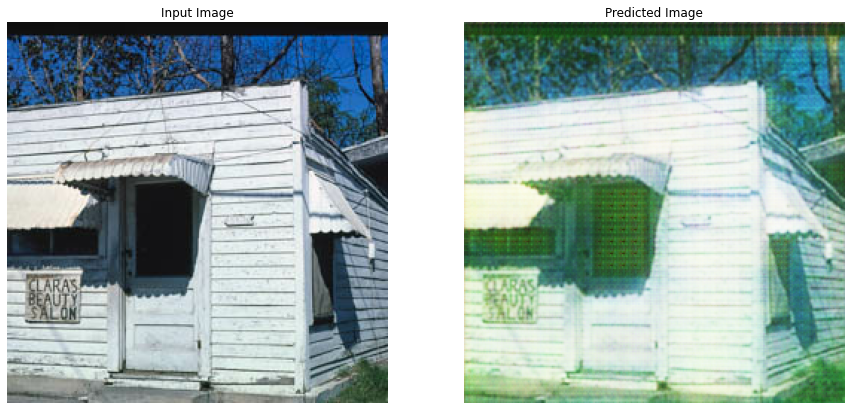

Time taken: 114.83547878265381
Epoch: 6
0
100
200
300
400
500
600
700


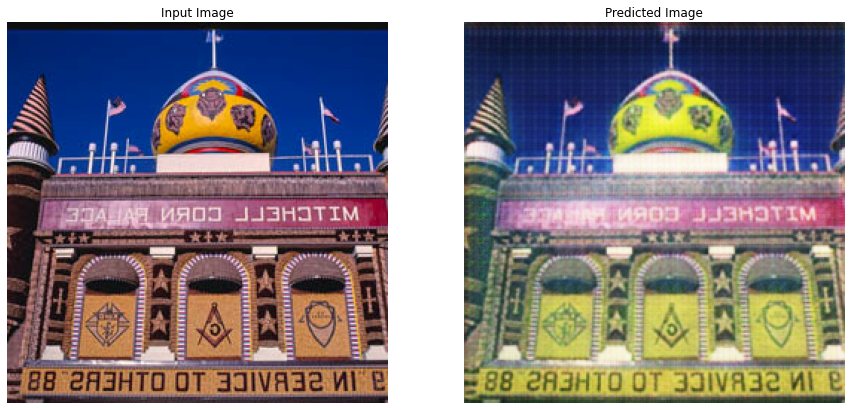

Time taken: 114.85243654251099
Epoch: 7
0
100
200
300
400
500
600
700


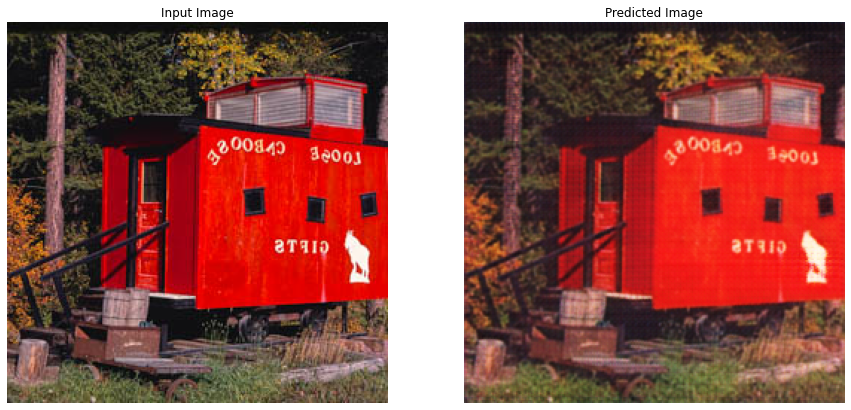

Time taken: 115.03615665435791
Epoch: 8
0
100
200
300
400
500
600
700


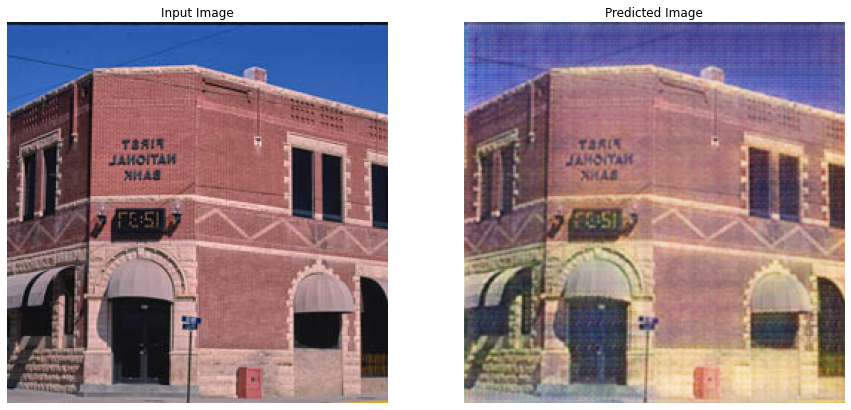

Time taken: 114.89456868171692
Epoch: 9
0
100
200
300
400
500
600
700


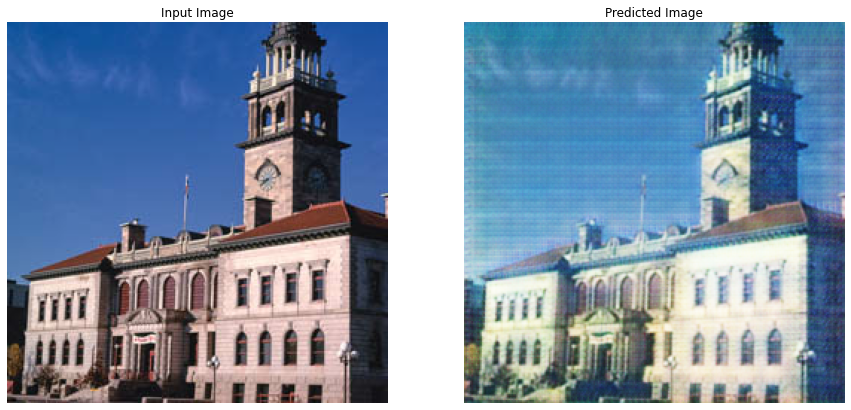

Time taken: 114.83840656280518
Epoch: 10
0
100
200
300
400
500
600
700


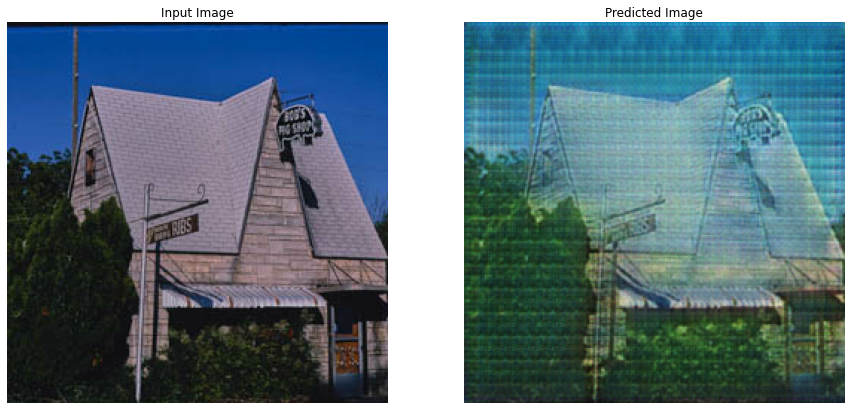

Time taken: 114.84253931045532
Epoch: 11
0
100
200
300
400
500
600
700


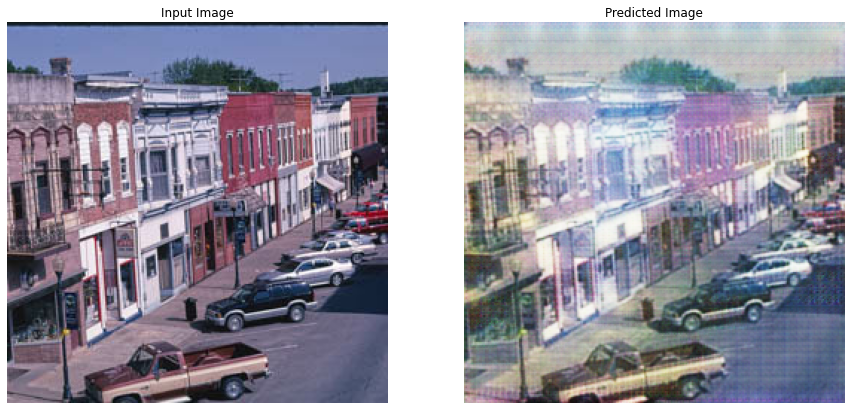

Time taken: 115.08868837356567
Epoch: 12
0
100
200
300
400
500
600
700


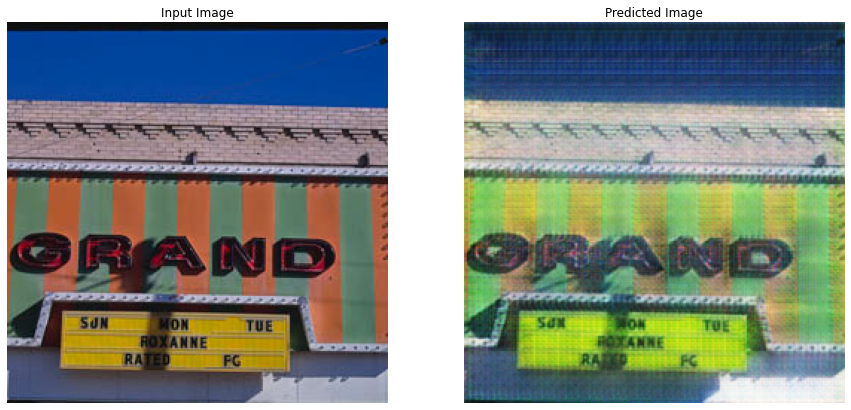

Time taken: 114.77948522567749
Epoch: 13
0
100
200
300
400
500
600
700


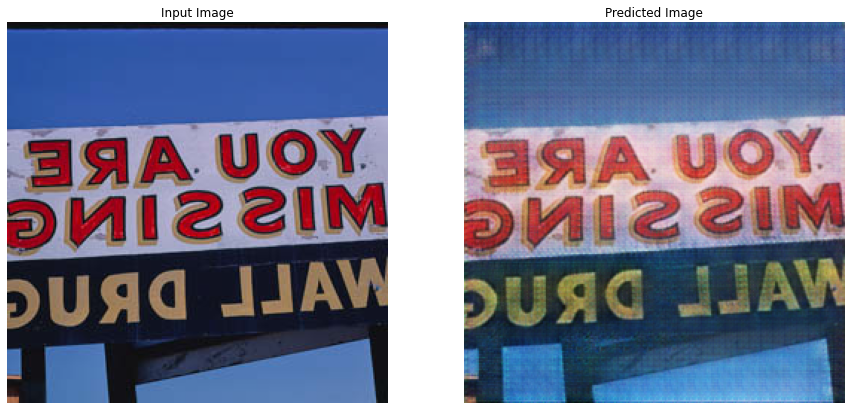

Time taken: 114.80017924308777
Epoch: 14
0
100
200
300
400
500
600
700


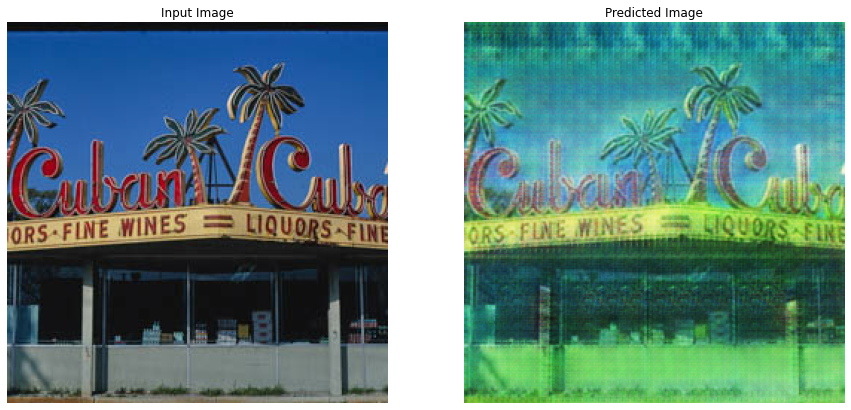

Time taken: 114.76287603378296
Epoch: 15
0
100
200
300
400
500
600
700


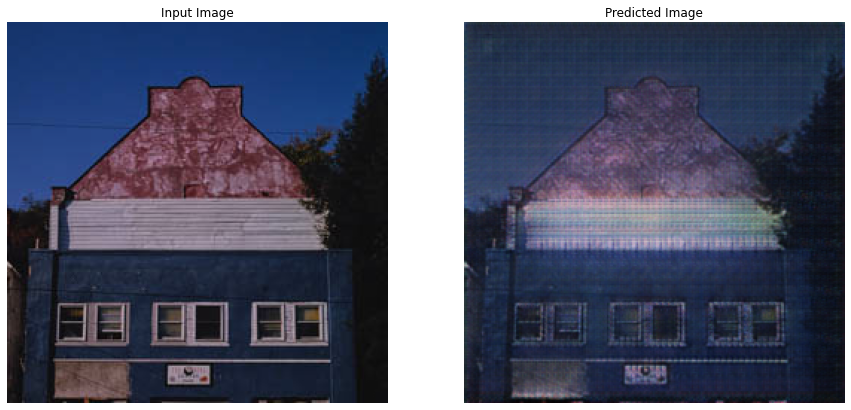

Time taken: 114.8151330947876
Epoch: 16
0
100
200
300
400
500
600
700


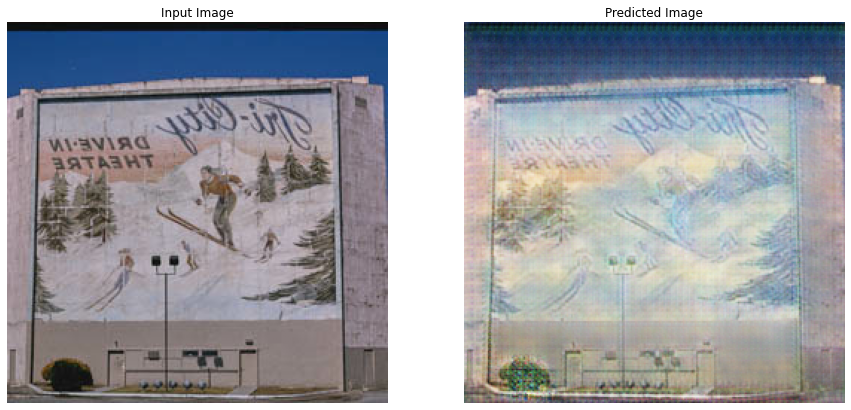

Time taken: 114.82387471199036
Epoch: 17
0
100
200
300
400
500
600
700


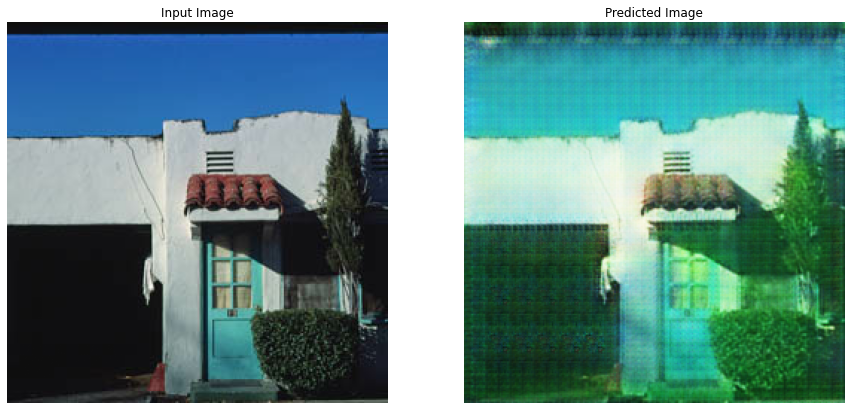

Time taken: 114.75618767738342
Epoch: 18
0
100
200
300
400
500
600
700


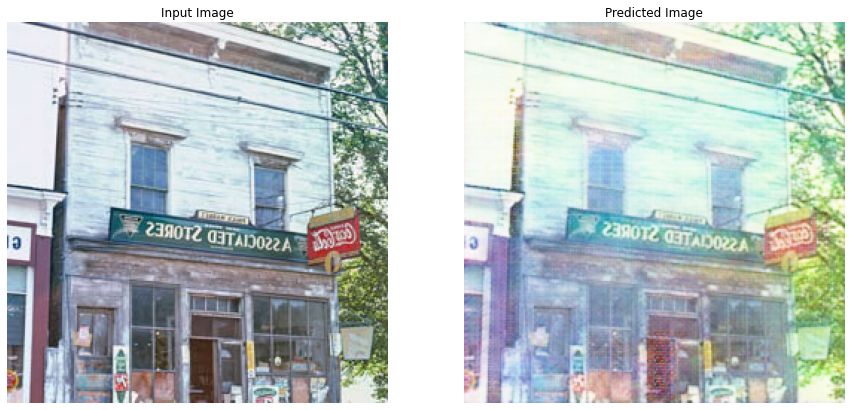

Time taken: 114.85095715522766
Epoch: 19
0
100
200
300
400
500
600
700


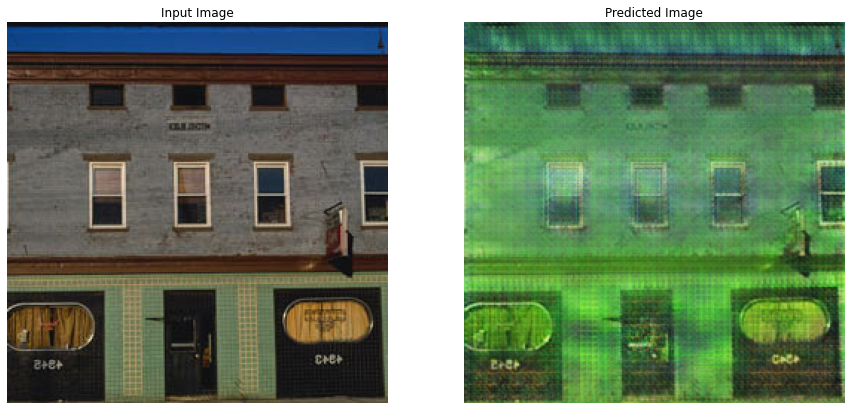

Saving checkpoint for epoch 20 at gdrive/My Drive/Capstone/CycleGANv4.2(l0.5nocrop)/training_checkpoints/ckpt-1
Time taken: 118.43666195869446
Epoch: 20
0
100
200
300
400
500
600
700


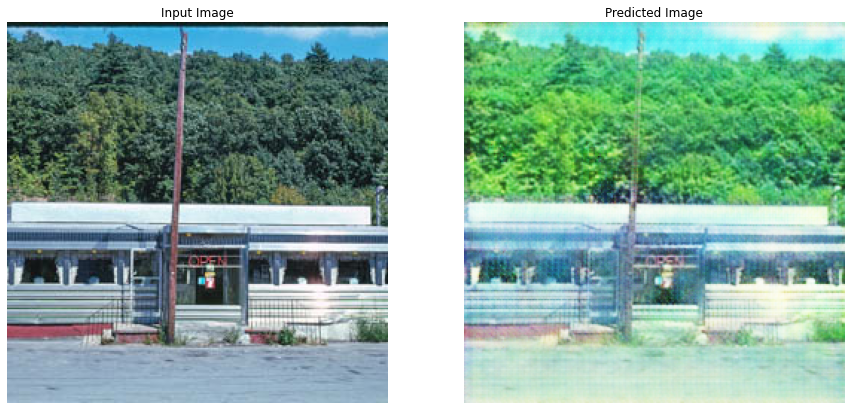

Time taken: 114.89577031135559
Epoch: 21
0
100
200
300
400
500
600
700


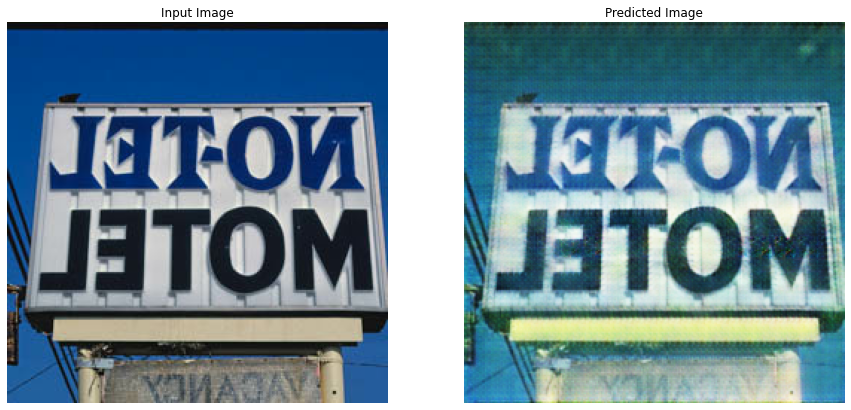

Time taken: 114.90960049629211
Epoch: 22
0
100
200
300
400
500
600
700


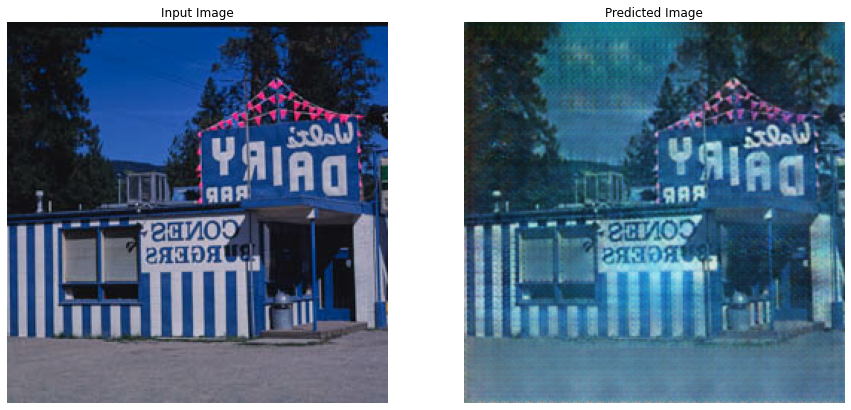

Time taken: 114.89980745315552
Epoch: 23
0
100
200
300
400
500
600
700


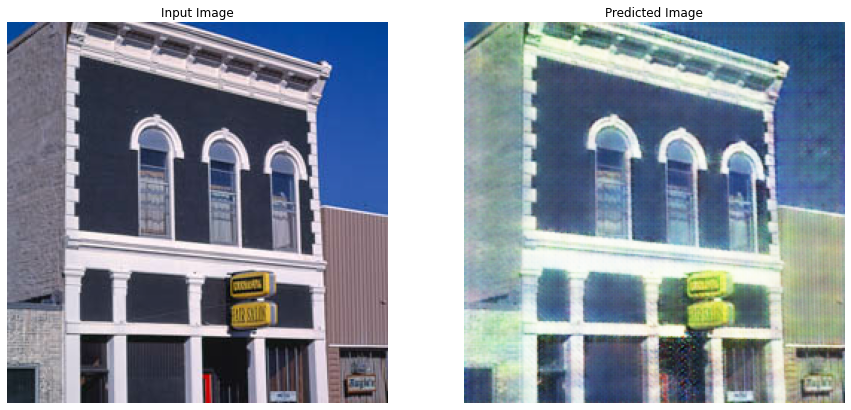

Time taken: 114.82890462875366
Epoch: 24
0
100
200
300
400
500
600
700


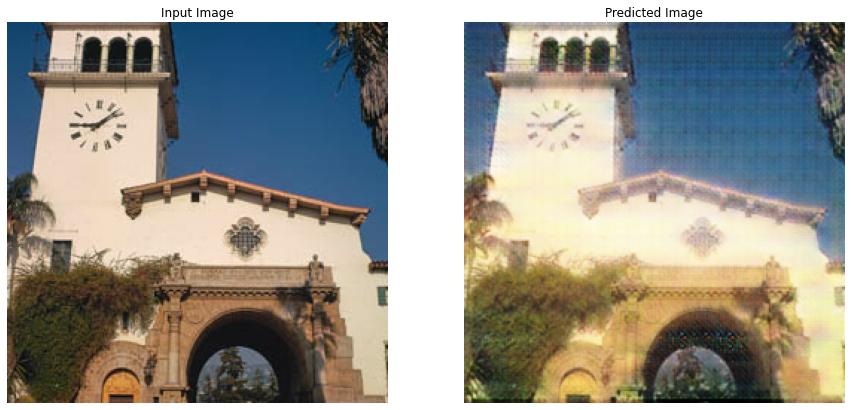

Time taken: 115.00458526611328
Epoch: 25
0
100
200
300
400
500
600
700


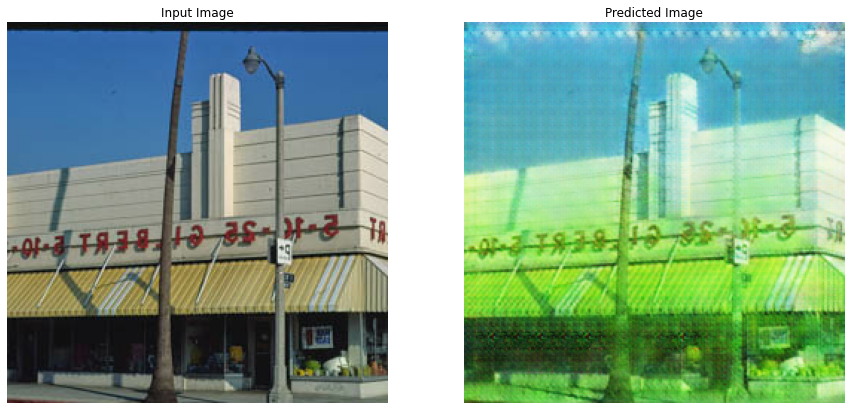

Time taken: 114.86349248886108
Epoch: 26
0
100
200
300
400
500
600
700


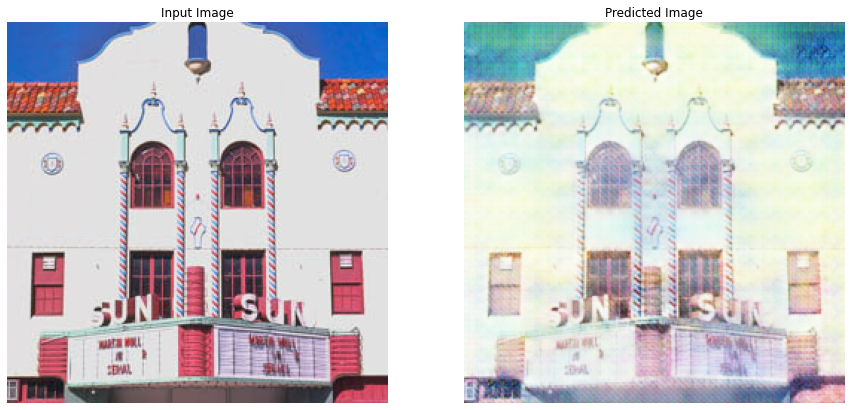

Time taken: 114.89790368080139
Epoch: 27
0
100
200
300
400
500
600
700


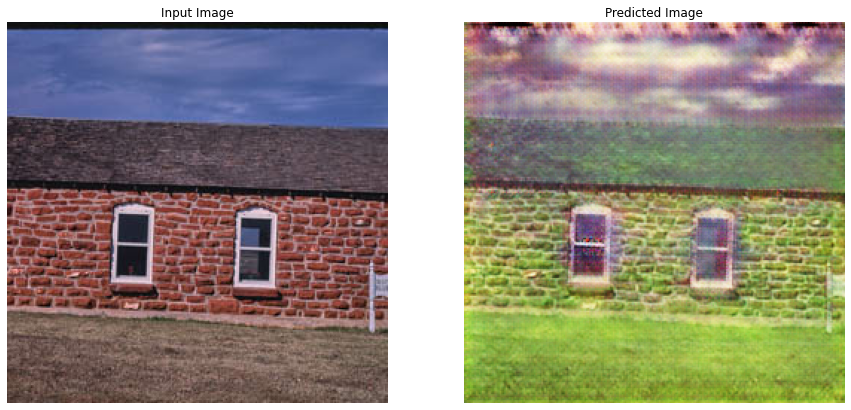

Time taken: 114.93072056770325
Epoch: 28
0
100
200
300
400
500
600
700


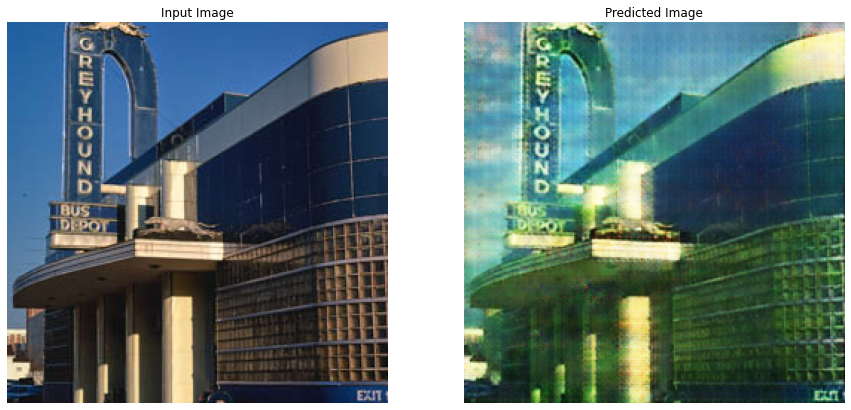

Time taken: 115.1254334449768
Epoch: 29
0
100
200
300
400
500
600
700


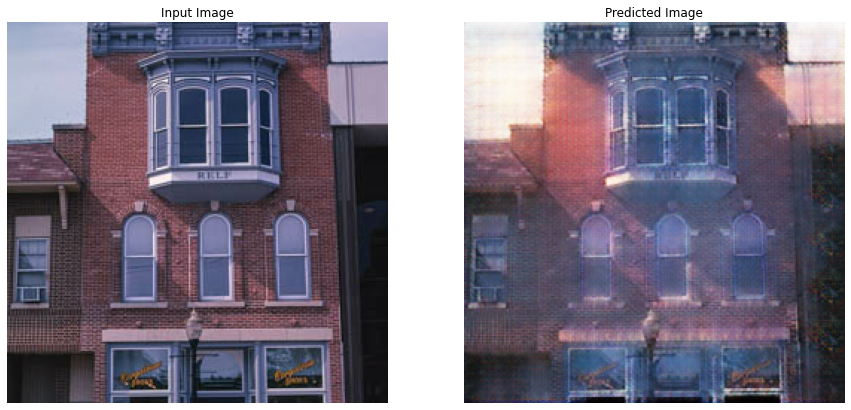

Time taken: 115.06877875328064
Epoch: 30
0
100
200
300
400
500
600
700


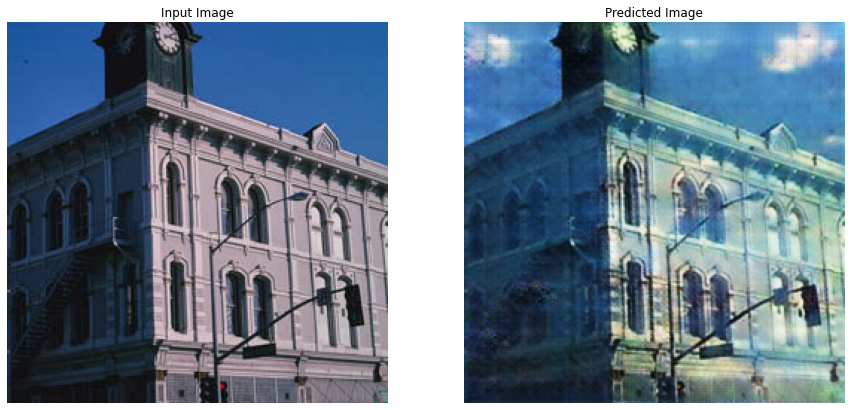

Time taken: 115.12132143974304
Epoch: 31
0
100
200
300
400
500
600
700


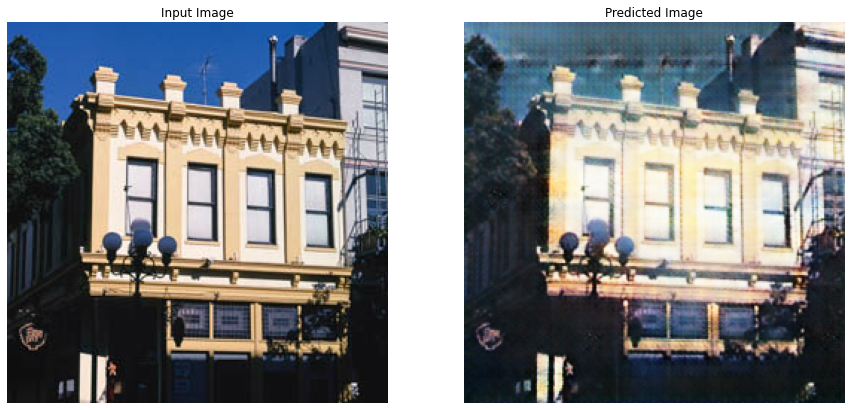

Time taken: 115.15944218635559
Epoch: 32
0
100
200
300
400
500
600
700


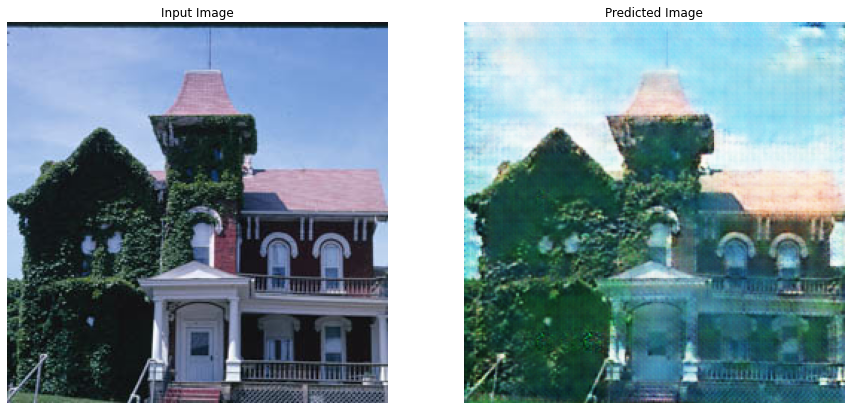

Time taken: 115.2157073020935
Epoch: 33
0
100
200
300
400
500
600
700


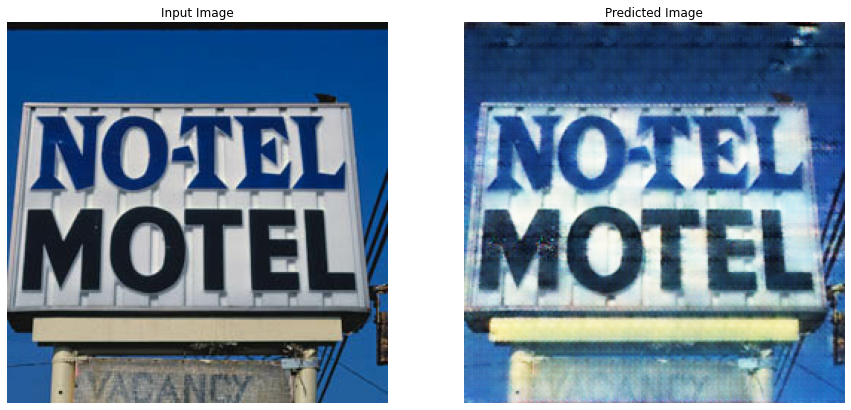

Time taken: 114.93831706047058
Epoch: 34
0
100
200
300
400
500
600
700


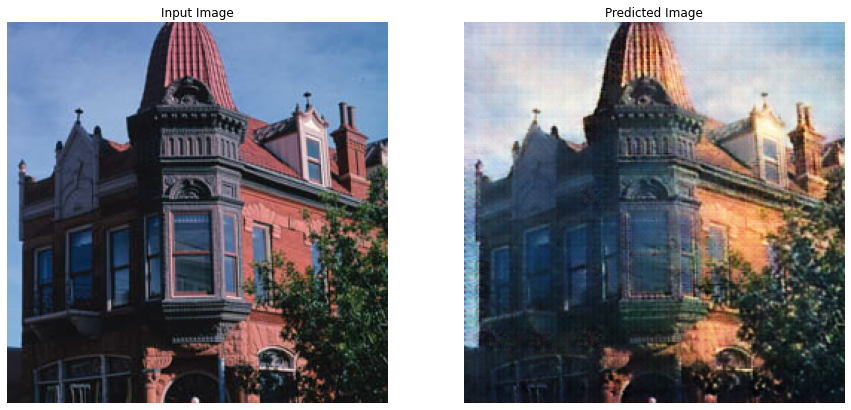

Time taken: 114.85081958770752
Epoch: 35
0
100
200
300
400
500
600
700


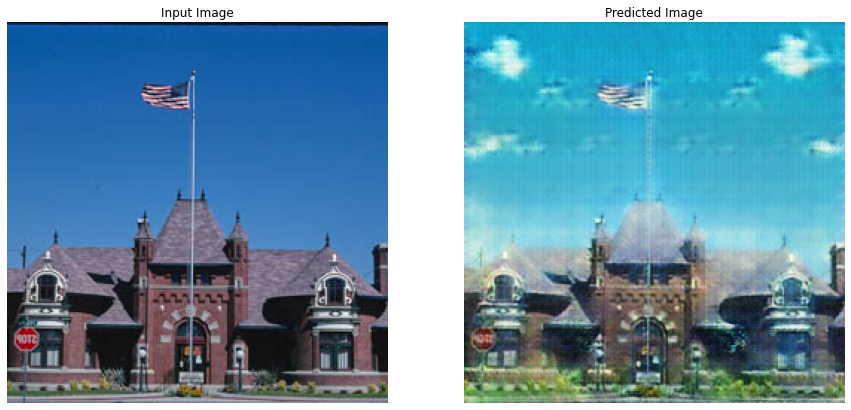

Time taken: 114.86532068252563
Epoch: 36
0
100
200
300
400
500
600
700


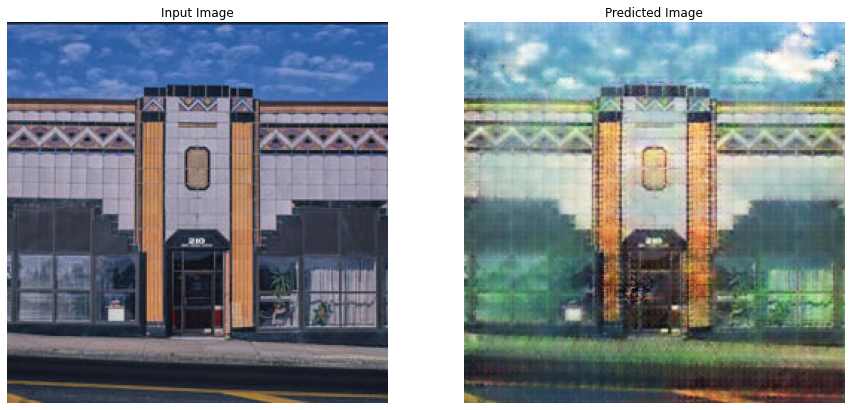

Time taken: 114.92731928825378
Epoch: 37
0
100
200
300
400
500
600
700


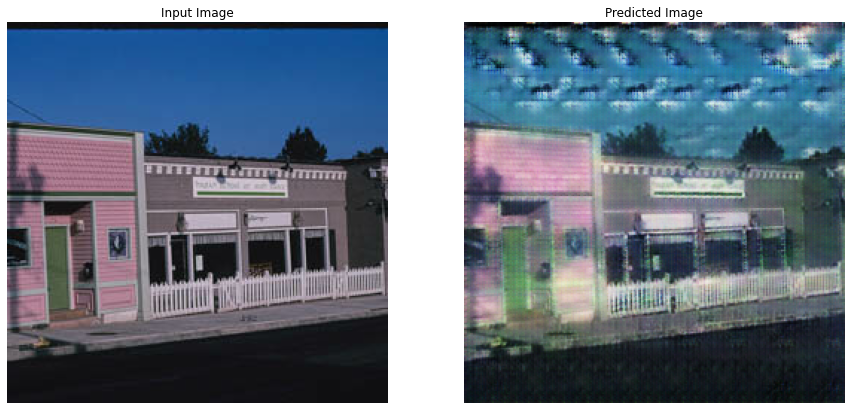

Time taken: 114.80121755599976
Epoch: 38
0
100
200
300
400
500
600
700


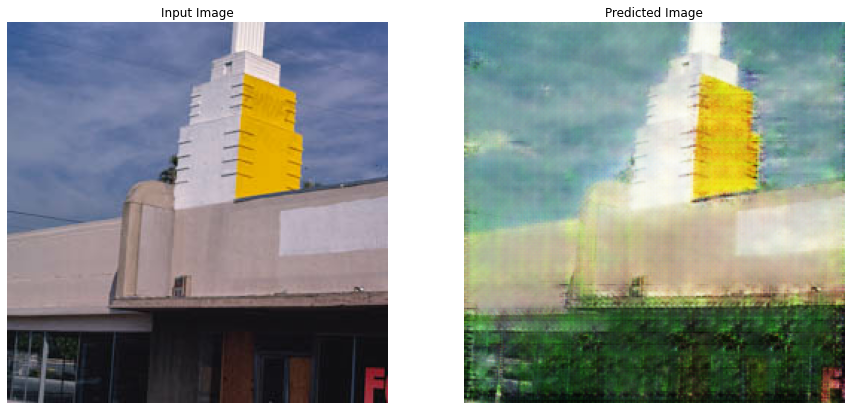

Time taken: 114.88648629188538
Epoch: 39
0
100
200
300
400
500
600
700


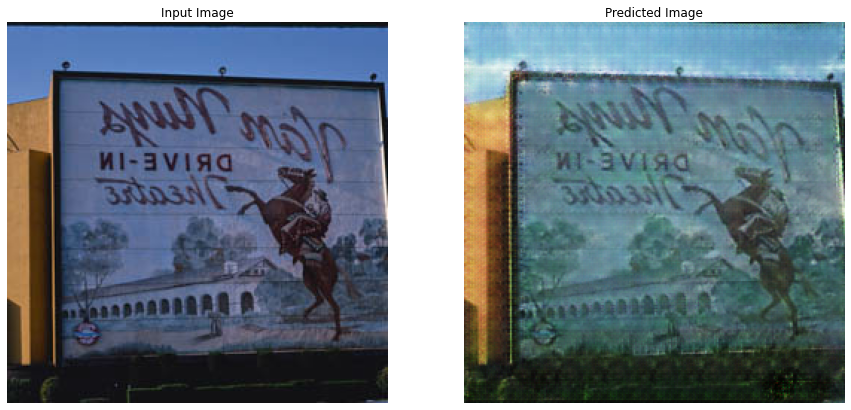

Saving checkpoint for epoch 40 at gdrive/My Drive/Capstone/CycleGANv4.2(l0.5nocrop)/training_checkpoints/ckpt-2
Time taken: 118.27086448669434
Epoch: 40
0
100
200
300
400
500
600
700


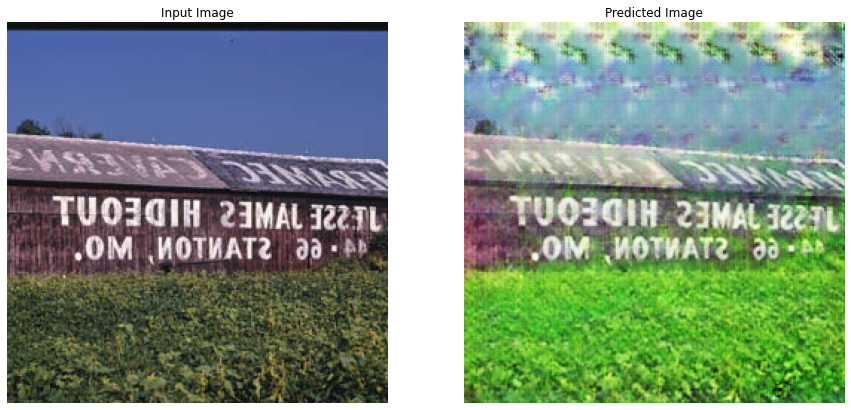

Time taken: 115.17876744270325
Epoch: 41
0
100
200
300
400
500
600
700


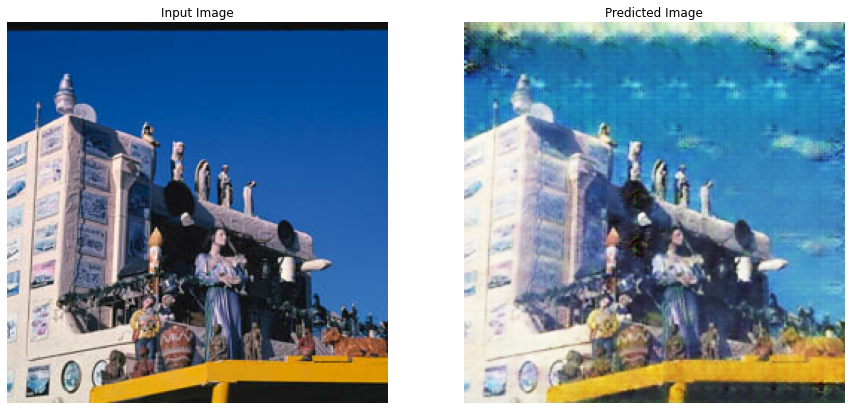

Time taken: 114.79028797149658
Epoch: 42
0
100
200
300
400
500
600
700


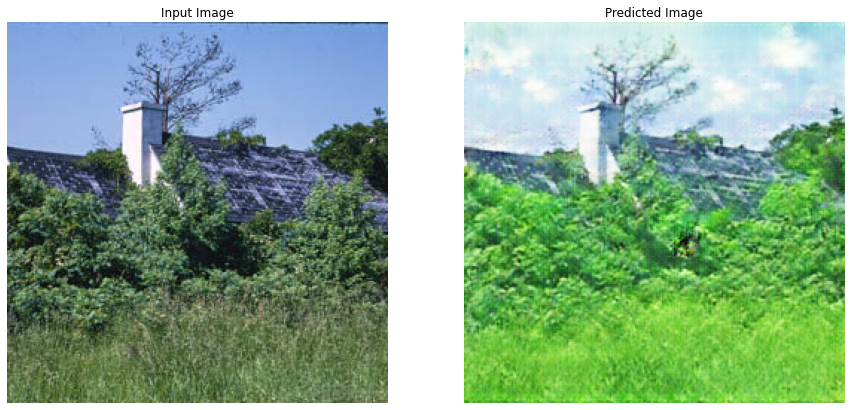

Time taken: 114.98678278923035
Epoch: 43
0
100
200
300
400
500
600
700


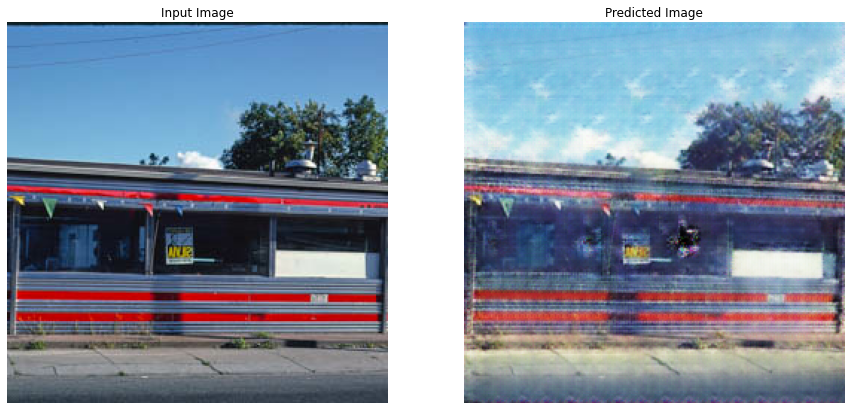

Time taken: 114.80787634849548
Epoch: 44
0
100
200
300
400
500
600
700


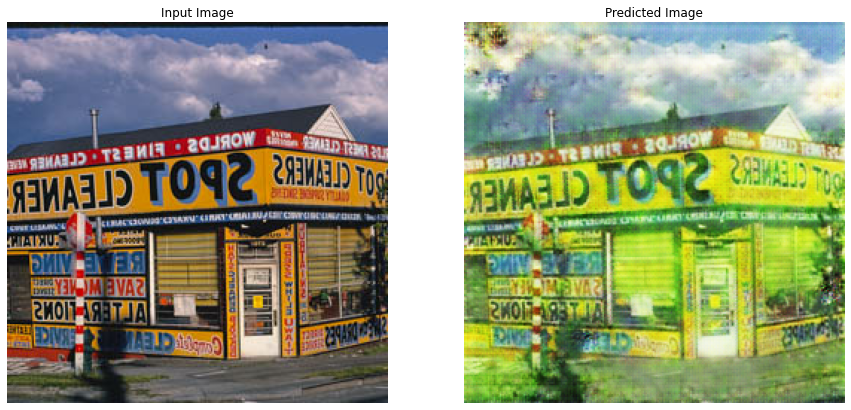

Time taken: 115.0648922920227
Epoch: 45
0
100
200
300
400
500
600
700


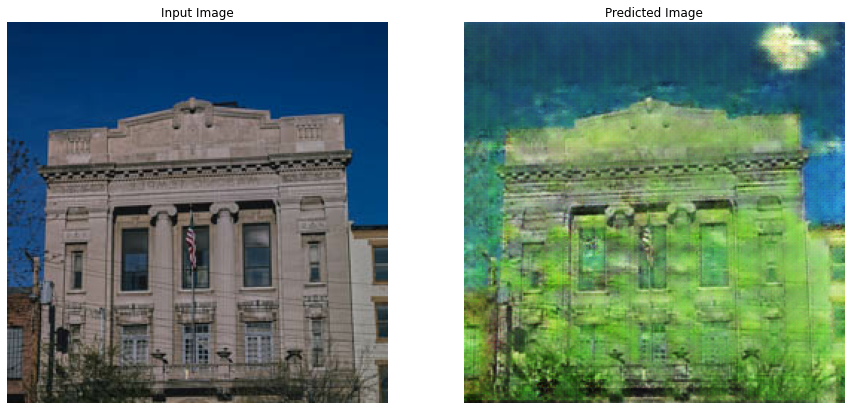

Time taken: 114.85145974159241
Epoch: 46
0
100
200
300
400
500
600
700


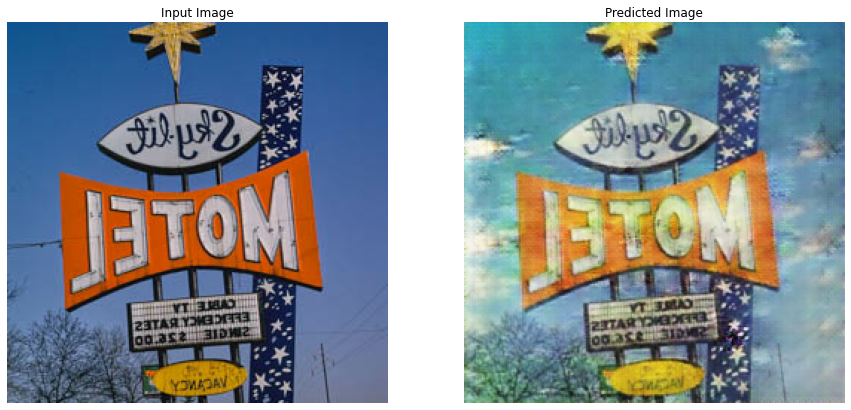

Time taken: 114.83031868934631
Epoch: 47
0
100
200
300
400
500
600
700


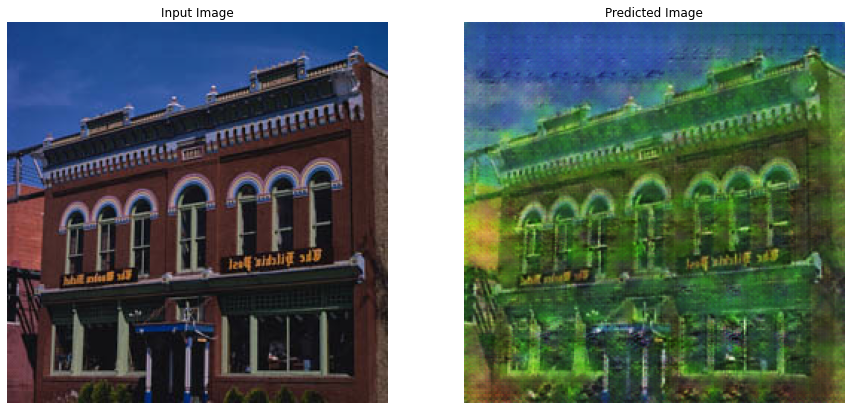

Time taken: 114.90979790687561
Epoch: 48
0
100
200
300
400
500
600
700


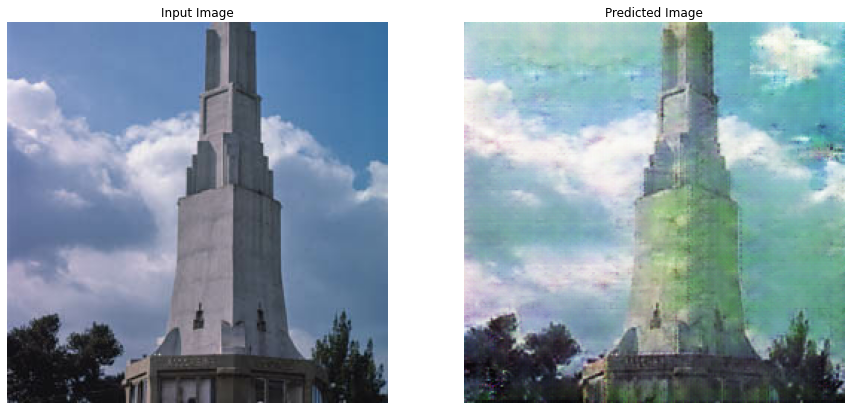

Time taken: 115.24968218803406
Epoch: 49
0
100
200
300
400
500
600
700


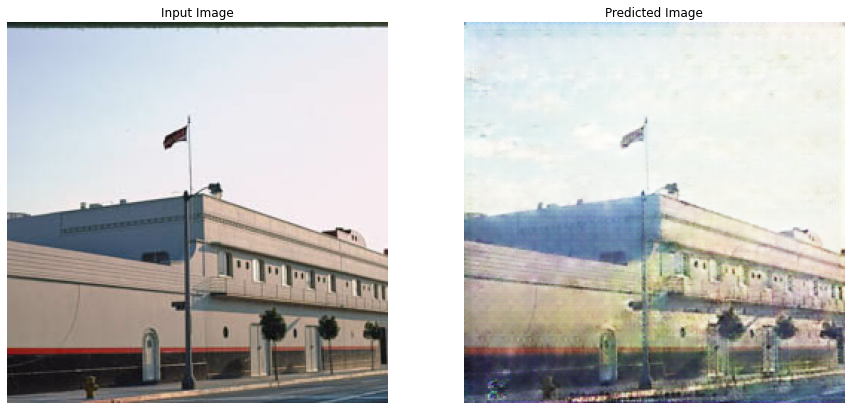

Time taken: 114.87798380851746
Epoch: 50
0
100
200
300
400
500
600
700


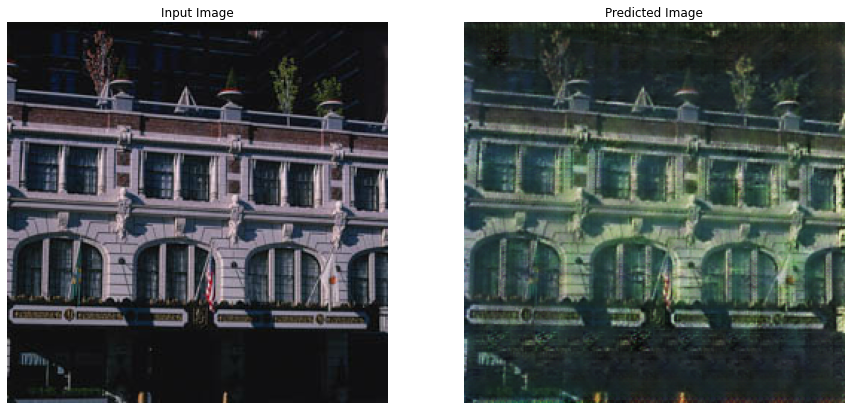

Time taken: 114.96945786476135
Epoch: 51
0
100
200
300
400
500
600
700


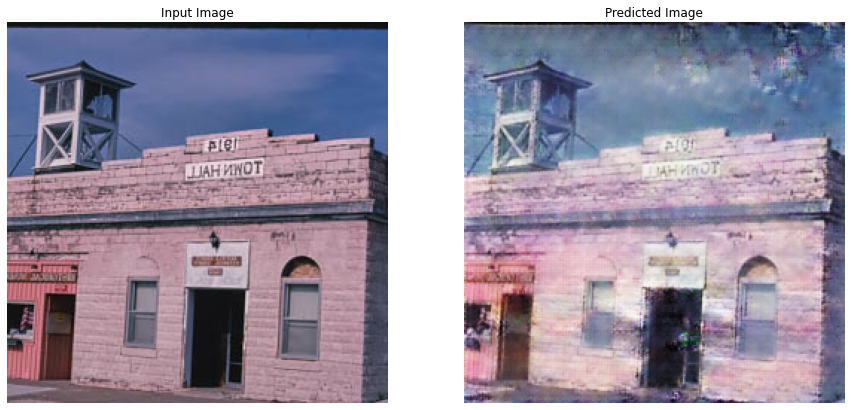

Time taken: 115.00553584098816
Epoch: 52
0
100
200
300
400
500
600
700


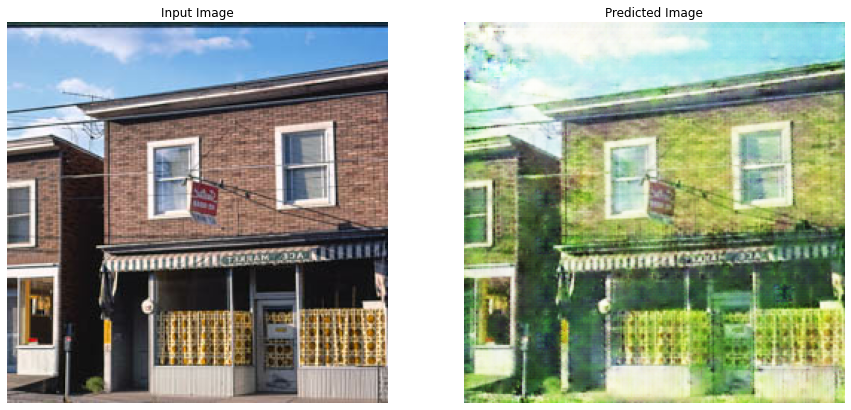

Time taken: 115.0376763343811
Epoch: 53
0
100
200
300
400
500
600
700


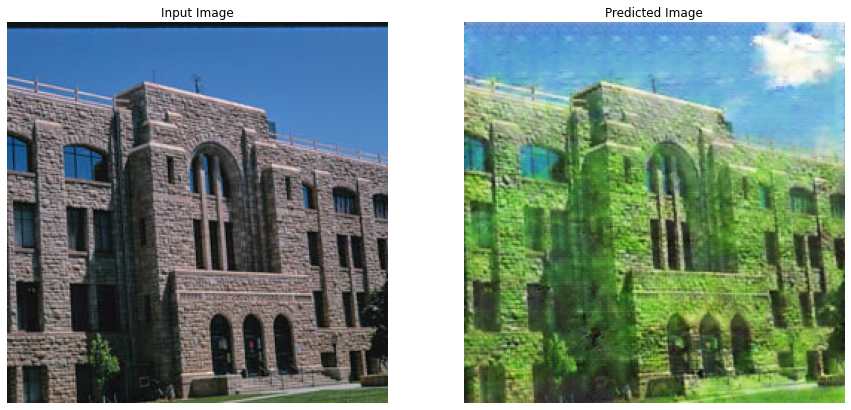

Time taken: 143.21794247627258
Epoch: 54
0
100
200
300
400
500
600
700


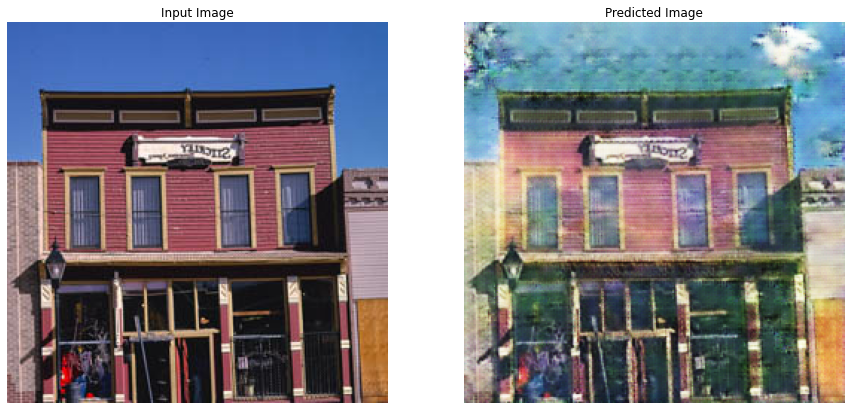

Time taken: 114.90607523918152
Epoch: 55
0
100
200
300
400
500
600
700


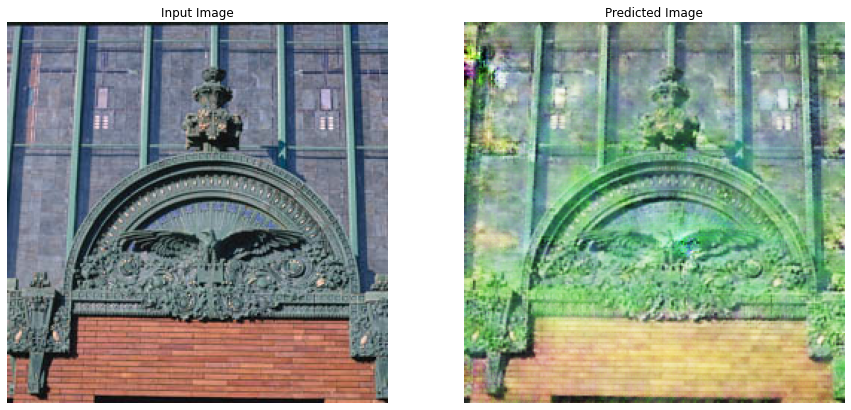

Time taken: 114.88273096084595
Epoch: 56
0
100
200
300
400
500
600
700


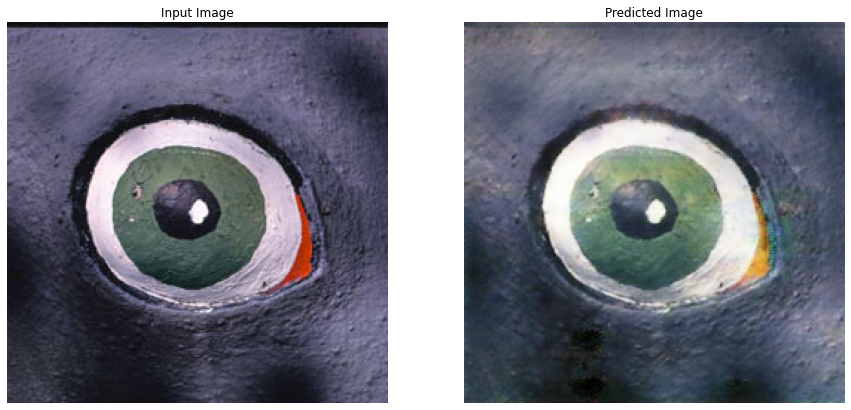

Time taken: 114.88726210594177
Epoch: 57
0
100
200
300
400
500
600
700


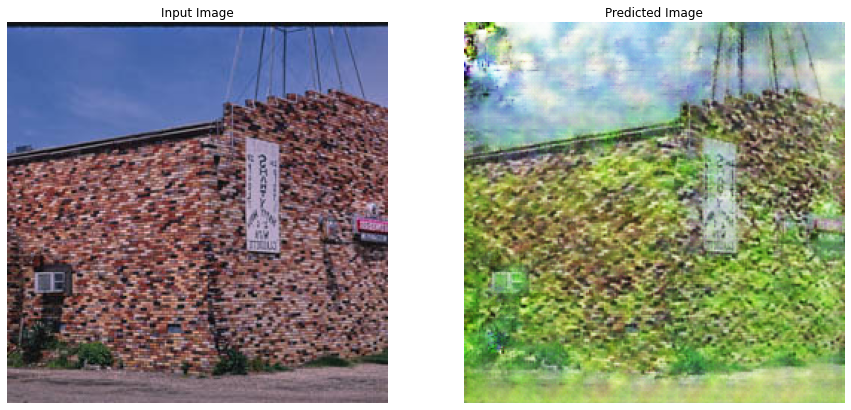

Time taken: 114.92595195770264
Epoch: 58
0
100
200
300
400
500
600
700


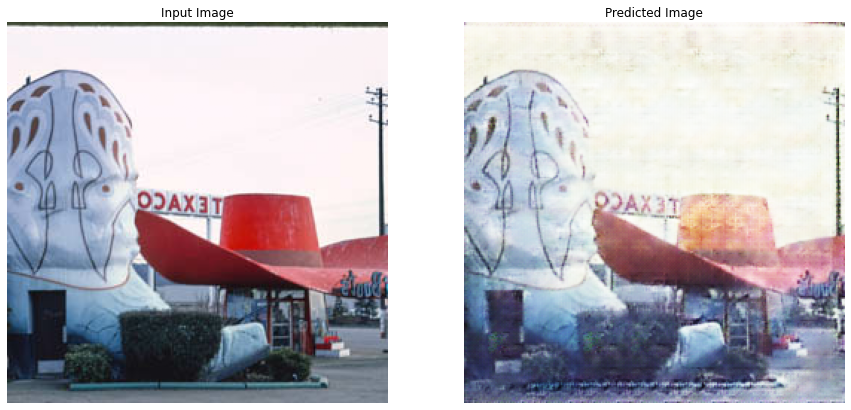

Time taken: 115.01094317436218
Epoch: 59
0
100
200
300
400
500
600
700


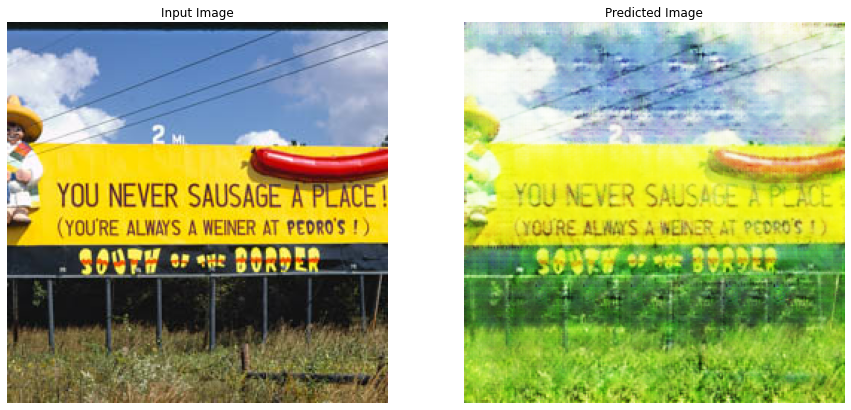

Saving checkpoint for epoch 60 at gdrive/My Drive/Capstone/CycleGANv4.2(l0.5nocrop)/training_checkpoints/ckpt-3
Time taken: 121.02804255485535
Epoch: 60
0
100
200
300
400
500
600
700


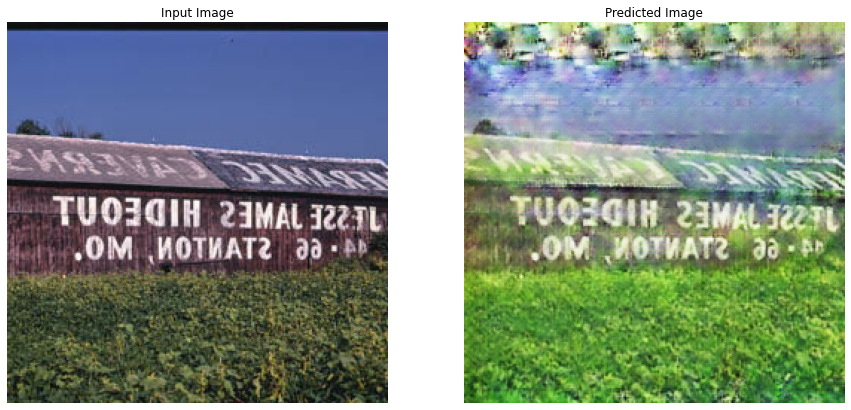

Time taken: 115.07128262519836
Epoch: 61
0
100
200
300
400
500
600
700


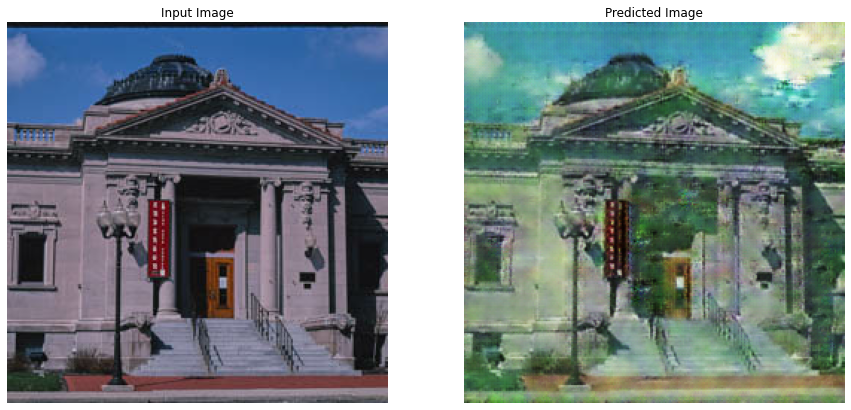

Time taken: 115.05562973022461
Epoch: 62
0
100
200
300
400
500
600
700


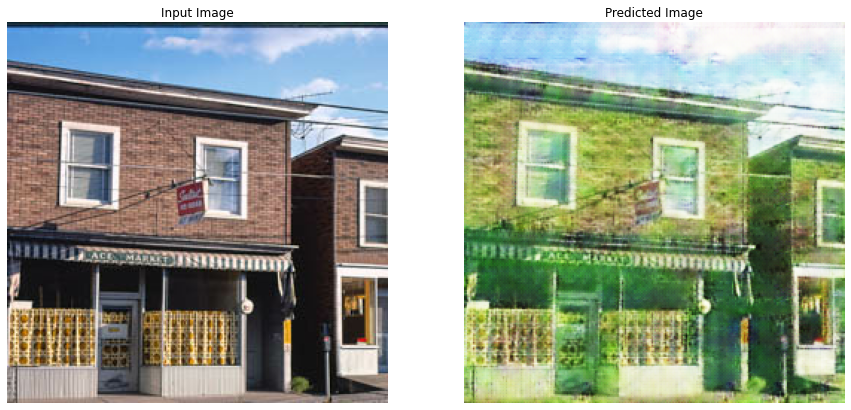

Time taken: 115.05513763427734
Epoch: 63
0
100
200
300
400
500
600
700


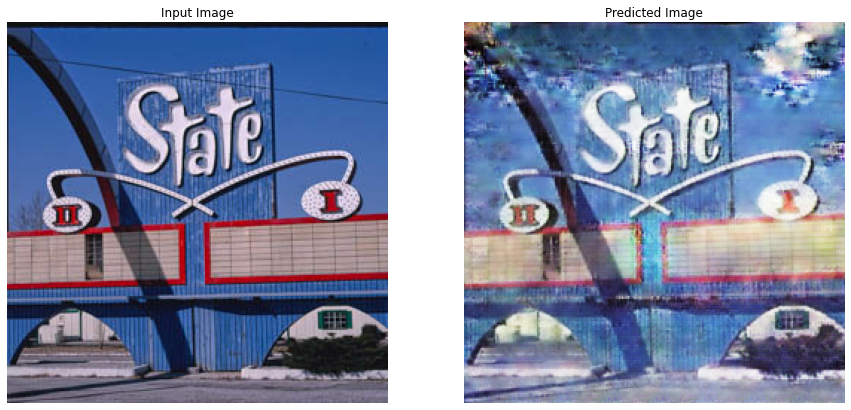

Time taken: 115.10572838783264
Epoch: 64
0
100
200
300
400
500
600
700


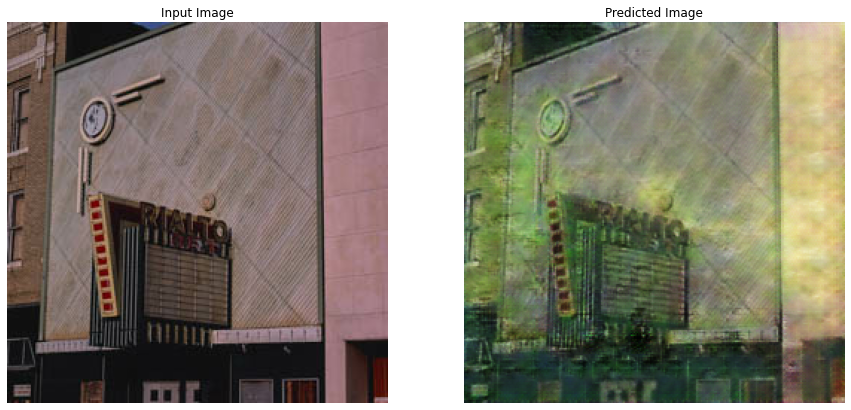

Time taken: 115.22758507728577
Epoch: 65
0
100
200
300


In [ ]:

# Manually loop through epochs
for epoch in range(epochs):
    print('Epoch: {}'.format(epoch))
    start = time.time()

    # Each batch
    for k, (real_x, real_y) in enumerate(tf.data.Dataset.zip((real_ds_train, anime_ds_train))):
        if k % 100 == 0: print(k)
        # Train step
        step(tf.reshape(real_x, (1, img_rows, img_cols, channels)), tf.reshape(real_y, (1, img_rows, img_cols, channels)))
    
    # View progress
    generate_images()

    # Save the model every 10 epochs
    if (epoch + 1) % 20 == 0:
      ckpt_save_path = ckpt_manager.save()
      print ('Saving checkpoint for epoch {} at {}'.format(epoch+1, 
                                                           ckpt_save_path))
    print('Time taken: {}'.format(time.time() - start))

## Generate Anime from Test Images

Generate Anime Samples from Test Real-Life Images

In [33]:
real_test_paths = ['../data/real_unsplash_6387/657887 Edited.jpg',
                  '../data/real_unsplash_6387/new york2288382 Edited.jpg',
                  '../data/real_unsplash_6387/new york2230563 Edited.jpg',
                  '../data/real_unsplash_6387/japan877484 Edited.jpg',
                  '../data/real_unsplash_6387/japan1061441 Edited.jpg',
                  '../data/real_unsplash_6387/japan990288 Edited.jpg']

def gen_test_image(test_image_path):
  real_test_image = tf.keras.preprocessing.image.load_img(test_image_path)
  input_arr_test = tf.keras.preprocessing.image.img_to_array(real_test_image)
  input_arr_test = np.array([input_arr_test])
  input_arr_test = preprocess_train_image(input_arr_test)
  input_arr_test = input_arr_test.numpy()
  plt.figure(figsize=(10, 5))
  predictions = generator_g.predict(input_arr_test.reshape((1, img_rows, img_cols, channels)))
  images = [input_arr_test[0], predictions[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
      plt.subplot(1, 2, i+1)
      plt.title(title[i])
      plt.imshow(images[i] * 0.5 + 0.5)
      plt.axis('off')
  # plt.tight_layout()
  plt.show()

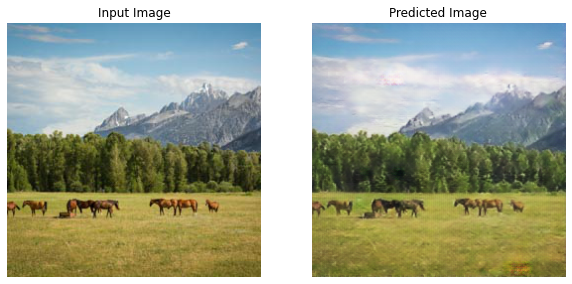

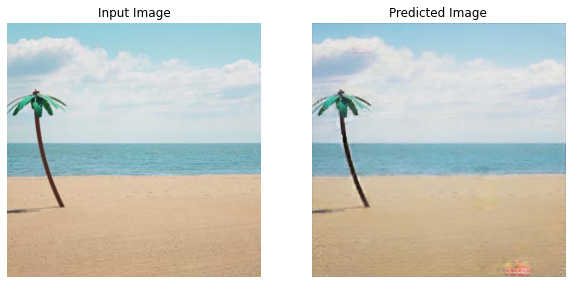

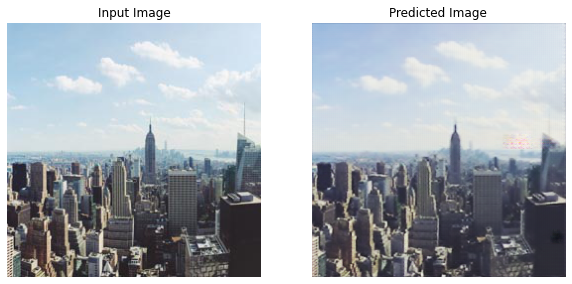

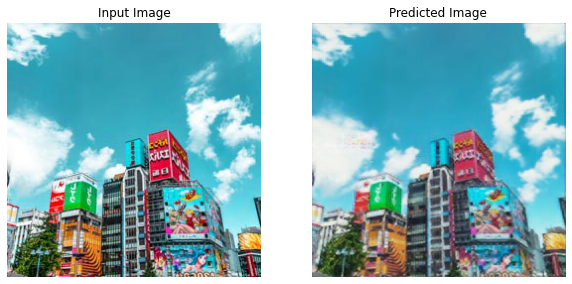

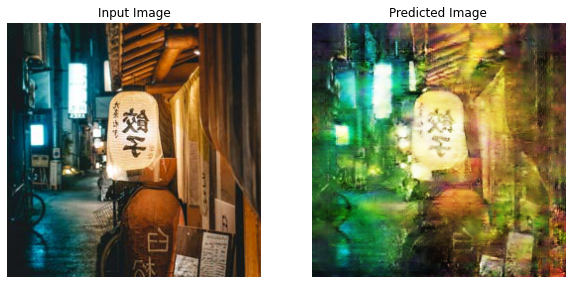

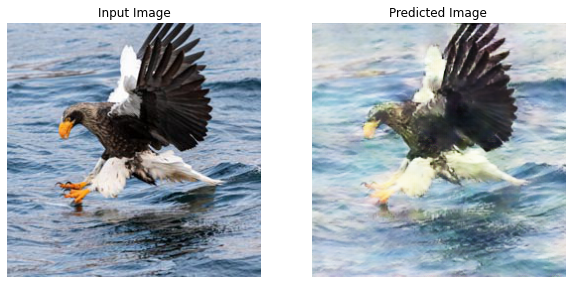

In [34]:
for test_image_path in real_test_paths:
  gen_test_image(test_image_path)

## Key Observations

The curated Ghibli dataset seems to have improved the generated anime images. Generally, there are less incoherent details in the generated images. On some real-life images with clear blue skies, the CycleGAN model even generated anime images that fill the skies with clouds. A key learning point is that although there is no need for paired images for CycleGAN, it is important that the themes of the input and target domain matches for better performance.

We will next try the CycleGAN model on cleaned images datasets for both real-life and anime domains in the next notebook "CycleGAN with Female Anime and Female Real"